In [ ]:
%cd /content/drive/MyDrive/DogNose

/content/drive/MyDrive/DogNose


In [ ]:
!pwd

/content/drive/MyDrive/DogNose


In [ ]:
!pip install -U openmim
!mim install mmcv-full

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
/usr/local/lib/python3.9/dist-packages/setuptools/command/install.py:34: SetuptoolsDeprecationWarning: setup.py install is deprecated. Use build and pip and other standards-based tools.
  warnings.warn(
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.openmmlab.com/mmcv/dist/cu118/torch2.0.0/index.html
  Using cached mmcv-full-1.7.1.tar.gz (605 kB)
  Preparing metadata (setup.py) ... done
  Using cached addict-2.4.0-py3-none-any.whl (3.8 kB)
  Using cached yapf-0.32.0-py2.py3-none-any.whl (190 kB)


In [ ]:
# !git clone https://github.com/open-mmlab/mmdetection.git
%cd mmdetection
!pip install -e .

/content/drive/MyDrive/DogNose/mmdetection
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Obtaining file:///content/drive/MyDrive/DogNose/mmdetection
  Preparing metadata (setup.py) ... canceled
ERROR: Operation cancelled by user


In [ ]:
import mmdet
print(mmdet.__version__)
# Example output: 2.23.0

/usr/local/lib/python3.9/dist-packages/mmcv/__init__.py:20: UserWarning: On January 1, 2023, MMCV will release v2.0.0, in which it will remove components related to the training process and add a data transformation module. In addition, it will rename the package names mmcv to mmcv-lite and mmcv-full to mmcv. See https://github.com/open-mmlab/mmcv/blob/master/docs/en/compatibility.md for more details.
  warnings.warn(


2.28.2


In [ ]:
import os
import os.path as osp
import torch
import torchvision
import numpy as np

# MMDetection

import mmdet
print(mmdet.__version__)
from mmdet.datasets import build_dataset
from mmdet.models import build_detector
from mmdet.apis import train_detector
from mmdet.datasets.builder import DATASETS
from mmdet.datasets.custom import CustomDataset
from mmdet.apis import set_random_seed

# MMCV
import mmcv
from mmcv import Config

# Weights and Biases
# import wandb
# print(wandb.__version__)

ModuleNotFoundError: ignored

In [ ]:
# !wget https://github.com/matterport/Mask_RCNN/releases/download/v2.1/balloon_dataset.zip
# !unzip -q balloon_dataset.zip

In [ ]:
# !git clone https://github.com/ZXWBOT/nose.git

In [ ]:
!python /content/drive/MyDrive/DogNose/mmdetection/nose/xml_to_csv.py

In [ ]:
import pandas as pd

df = pd.read_csv('/content/drive/MyDrive/DogNose/mmdetection/nose/road_signs_labels.csv')
df.sort_values(by=['filename'], axis=0)
df.head(2)

In [ ]:
!python /content/drive/MyDrive/DogNose/mmdetection/nose/convert_csv_to_coco.py

In [ ]:
import json
import os
import random


def split_dataset(input_json, val_ratio, random_seed):
    random.seed(random_seed)

    with open(input_json) as json_reader:
        dataset = json.load(json_reader)

    images = dataset['images']
    annotations = dataset['annotations']
    categories = dataset['categories']

    # file_name에 prefix 디렉토리까지 포함 (CocoDataset 클래스를 사용하는 경우)
    for image in images:
        image['file_name'] = '{}'.format(image['file_name'])

    image_ids = [x.get('id') for x in images]
    image_ids.sort()
    random.shuffle(image_ids)

    num_val = int(len(image_ids) * val_ratio)
    num_train = len(image_ids) - num_val

    image_ids_val, image_ids_train = set(image_ids[:num_val]), set(image_ids[num_val:])

    train_images = [x for x in images if x.get('id') in image_ids_train]
    val_images = [x for x in images if x.get('id') in image_ids_val]
    train_annotations = [x for x in annotations if x.get('image_id') in image_ids_train]
    val_annotations = [x for x in annotations if x.get('image_id') in image_ids_val]

    train_data = {
        'images': train_images,
        'annotations': train_annotations,
        'categories': categories,
    }

    val_data = {
        'images': val_images,
        'annotations': val_annotations,
        'categories': categories,
    }

In [ ]:
split_dataset(input_json='/content/drive/MyDrive/DogNose/mmdetection/nose/annotation_coco.json',
              val_ratio=0.1,
              random_seed=2023)

In [ ]:
!pwd

/content/drive/MyDrive/DogNose/mmdetection


In [ ]:
!mkdir checkpoints
!wget -O /content/drive/MyDrive/DogNose/mmdetection/checkpoints/faster_rcnn_r50_fpn_1x_coco_20200130-047c8118.pth http://download.openmmlab.com/mmdetection/v2.0/faster_rcnn/faster_rcnn_r50_fpn_1x_coco/faster_rcnn_r50_fpn_1x_coco_20200130-047c8118.pth

mkdir: cannot create directory ‘checkpoints’: File exists
--2023-03-13 06:33:14--  http://download.openmmlab.com/mmdetection/v2.0/faster_rcnn/faster_rcnn_r50_fpn_1x_coco/faster_rcnn_r50_fpn_1x_coco_20200130-047c8118.pth
Resolving download.openmmlab.com (download.openmmlab.com)... 8.48.85.209, 8.48.85.207, 8.48.85.213, ...
Connecting to download.openmmlab.com (download.openmmlab.com)|8.48.85.209|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 167287506 (160M) [application/octet-stream]
Saving to: ‘/content/drive/MyDrive/DogNose/mmdetection/checkpoints/faster_rcnn_r50_fpn_1x_coco_20200130-047c8118.pth’

/content/drive/MyDr 100%[===================>] 159.54M  34.9MB/s    in 4.6s    

2023-03-13 06:33:19 (34.3 MB/s) - ‘/content/drive/MyDrive/DogNose/mmdetection/checkpoints/faster_rcnn_r50_fpn_1x_coco_20200130-047c8118.pth’ saved [167287506/167287506]



In [ ]:
config_file = '/content/drive/MyDrive/DogNose/mmdetection/configs/faster_rcnn/faster_rcnn_r50_fpn_1x_coco.py'
checkpoint_file = '/content/drive/MyDrive/DogNose/mmdetection/checkpoints/faster_rcnn_r50_fpn_1x_coco_20200130-047c8118.pth'

cfg = Config.fromfile(config_file)

In [ ]:
# Define type and path to the images.
cfg.dataset_type = 'CocoDetection'

cfg.data.test.ann_file = '/content/drive/MyDrive/DogNose/mmdetection/nose/val/annotation_coco2.json'
cfg.data.test.img_prefix = '/content/drive/MyDrive/DogNose/mmdetection/nose/images/'
cfg.data.test.classes = ('nose',)
# cfg.data.test.dataset_type= 'COCODetection'

cfg.data.train.ann_file = '/content/drive/MyDrive/DogNose/mmdetection/nose/train/annotation_coco2.json'
cfg.data.train.img_prefix = '/content/drive/MyDrive/DogNose/mmdetection/nose/images/'
cfg.data.train.classes = ('nose',)
# cfg.data.train.dataset_type= 'COCODetection'

cfg.data.val.ann_file = '/content/drive/MyDrive/DogNose/mmdetection/nose/val/annotation_coco2.json'
cfg.data.val.img_prefix = '/content/drive/MyDrive/DogNose/mmdetection/nose/images/'
cfg.data.val.classes = ('nose',)
# cfg.data.val.dataset_type= 'COCODetection'

In [ ]:
# modify num classes of the model in box head and mask head
cfg.model.roi_head.bbox_head.num_classes = 1
# cfg.model.roi_head.mask_head.num_classes = 1

# Use the pretrained model.
cfg.load_from = '/content/drive/MyDrive/DogNose/mmdetection/checkpoints/faster_rcnn_r50_fpn_1x_coco_20200130-047c8118.pth'
     

In [ ]:
# cfg.dataset_type = 'COCODetection'

In [ ]:
# cfg.dataset_type

In [ ]:

# The original learning rate (LR) is set for 8-GPU training.
# We divide it by 8 since we only use one GPU.
cfg.optimizer.lr = 0.02 / 8

cfg.lr_config.warmup = None
cfg.log_config.interval = 10

# Epochs
cfg.runner.max_epochs = 50

# Set seed thus the results are more reproducible
cfg.seed = 0
set_random_seed(0, deterministic=False)
cfg.gpu_ids = range(1)

# ⭐️ Set the checkpoint interval.
cfg.checkpoint_config.interval = 10

# Set up working dir to save files and logs.

cfg.work_dir = '/content/drive/MyDrive/DogNose/outputs/baseline-rmclosedataset'
cfg.device = 'cuda'



In [ ]:
# ⭐️ Set the evaluation interval.
cfg.evaluation.interval = 2

In [ ]:
cfg.seed = 0
set_random_seed(0, deterministic=False)
cfg.gpu_ids = range(1)
cfg.device = 'cuda'
cfg.runner.max_epochs = 50
# We can also use tensorboard to log the training process
cfg.log_config.hooks = [
    dict(type='TextLoggerHook'),
    dict(type='TensorboardLoggerHook')]

In [ ]:
from mmdet.datasets import build_dataset
from mmdet.models import build_detector
from mmdet.apis import train_detector
# from cfg import cfg
import os.path as osp
import mmcv
# Build dataset
datasets = [build_dataset(cfg.data.train)]
# Build the detector
model = build_detector(cfg.model)
# Add an attribute for visualization convenience
model.CLASSES = datasets[0].CLASSES
# Create work_dir
mmcv.mkdir_or_exist(osp.abspath(cfg.work_dir))
train_detector(model, datasets, cfg, distributed=False, validate=True)

In [ ]:
!lsof -n -i -P | grep 6006

tensorboa 36409 root   11u  IPv4  872841      0t0  TCP 127.0.0.1:6006 (LISTEN)


In [ ]:
!kill -9 36409

/bin/bash: line 0: kill: (36409) - No such process


In [ ]:
# !pip install tensorboard 
%reload_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/DogNose/outputs

Reusing TensorBoard on port 6006 (pid 14084), started 0:00:37 ago. (Use '!kill 14084' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
# Define type and path to the images.
cfg.dataset_type = 'CocoDetection'

cfg.data.test.ann_file = '/content/drive/MyDrive/DogNose/mmdetection/nose/val/annotation_coco.json'
cfg.data.test.img_prefix = '/content/drive/MyDrive/DogNose/mmdetection/nose/images/'
cfg.data.test.classes = ('nose',)
# cfg.data.test.dataset_type= 'COCODetection'

cfg.data.train.ann_file = '/content/drive/MyDrive/DogNose/mmdetection/nose/train/annotation_coco.json'
cfg.data.train.img_prefix = '/content/drive/MyDrive/DogNose/mmdetection/nose/images/'
cfg.data.train.classes = ('nose',)
# cfg.data.train.dataset_type= 'COCODetection'

cfg.data.val.ann_file = '/content/drive/MyDrive/DogNose/mmdetection/nose/val/annotation_coco.json'
cfg.data.val.img_prefix = '/content/drive/MyDrive/DogNose/mmdetection/nose/images/'
cfg.data.val.classes = ('nose',)
# cfg.data.val.dataset_type= 'COCODetection'
cfg.work_dir = '/content/drive/MyDrive/DogNose/outputs/baseline-basedataset'
cfg.device = 'cuda'

In [ ]:
import ipywidgets
import matplotlib.pyplot as plt
import cv2
from mmdet.apis import show_result_pyplot
from mmdet.apis import inference_detector
from mmdet.apis import init_detector

import mmcv
import glob as glob
import os
from PIL import Image

weights = '/content/drive/MyDrive/DogNose/outputs/baseline-basedataset/epoch_50.pth'

# Build the model.

model = init_detector(cfg, weights, device='cuda:0')
# model = init_detector(cfg, args['weights'])

# fig = plt.figure(figsize=(20,40)) 
# rows = 1
# cols = 5

file_name = [14]
for i, name in enumerate(file_name):
    img = "/content/drive/MyDrive/DogNose/mmdetection/nose/images/"+str(name)+".png"
    img = mmcv.imread(img)
    results = inference_detector(model, img)
    
    show_result_pyplot(model, img, results, out_file="/content/drive/MyDrive/DogNose/resultimage/"+str(name)+".png")

# plt.show()

load checkpoint from local path: /content/drive/MyDrive/DogNose/outputs/baseline-basedataset/epoch_50.pth


load checkpoint from local path: /content/drive/MyDrive/DogNose/outputs/baseline-basedataset/epoch_50.pth
1


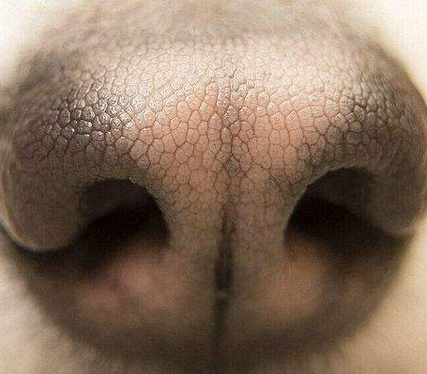

10


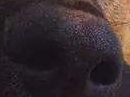

11


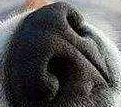

12


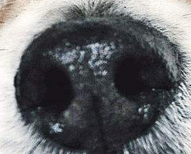

13


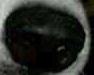

14


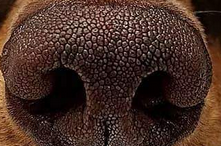

15


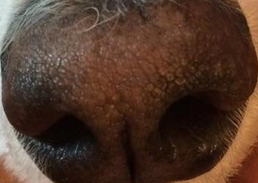

16


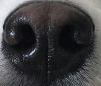

17


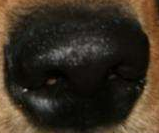

18


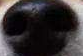

19


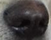

2


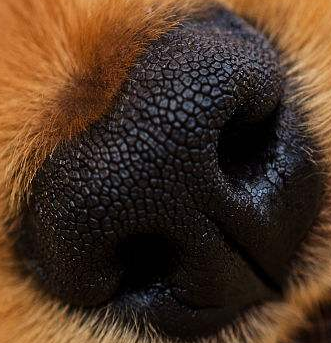

20


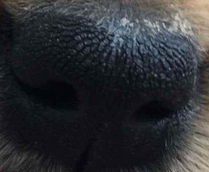

21


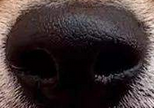

22


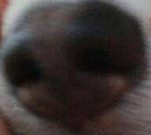

23


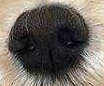

24


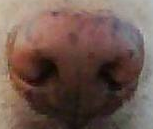

25


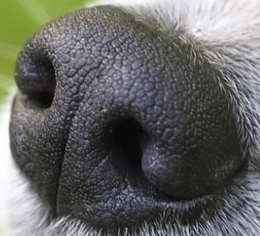

26


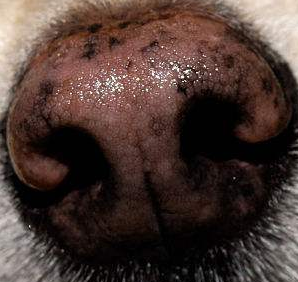

27


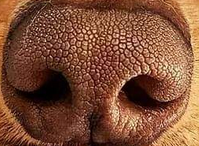

28


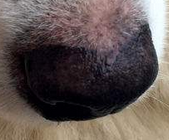

29


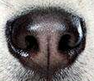

3


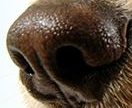

30


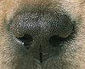

31


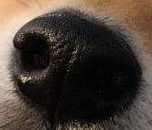

32


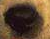

33


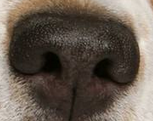

34


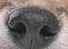

35


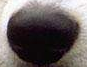

36


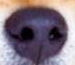

37


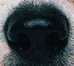

38


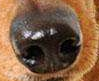

39


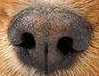

4


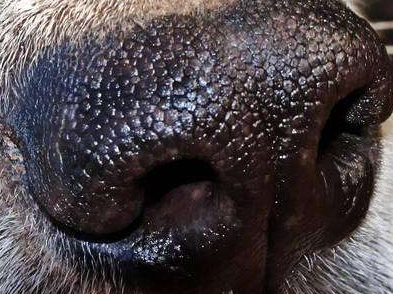

40


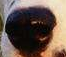

41


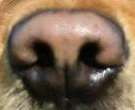

42


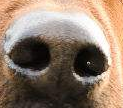

43


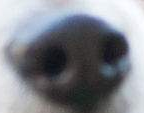

44


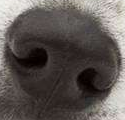

45


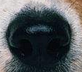

46


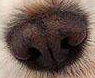

47


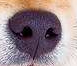

48


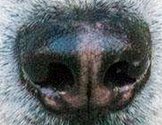

49


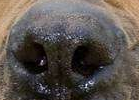

5


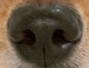

50


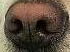

6


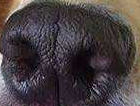

7


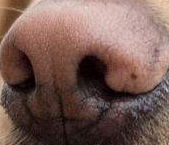

8


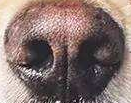

9


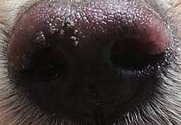

In [ ]:
import ipywidgets
import matplotlib.pyplot as plt
import cv2
from mmdet.apis import show_result_pyplot
from mmdet.apis import inference_detector
from mmdet.apis import init_detector

import mmcv
import glob as glob
import os
from PIL import Image
import pandas as pd
weights = '/content/drive/MyDrive/DogNose/outputs/baseline-basedataset/epoch_50.pth'

df = pd.read_csv("/content/drive/MyDrive/DogNose/mmdetection/nose/road_signs_labels.csv")

model = init_detector(cfg, weights, device='cuda:0')

file_name = [14]
for i, data in df.iterrows():
    img_path = "/content/drive/MyDrive/DogNose/mmdetection/nose/images/"+data['filename']
    print(data['filename'][:-4])
    img = mmcv.imread(img_path)
    results = inference_detector(model, img)
    bbox_result = results
    labels = [
        np.full(bbox.shape[0], i, dtype=np.int32)\
        for i, bbox in enumerate(bbox_result)
    ]
    labels = np.concatenate(labels)
    bboxes = np.vstack(bbox_result)
    labels_impt = np.where(bboxes[:, -1] > 0.3)[0]

    # classes = get_classes("nose")
    # labels_impt_list = [labels[i] for i in labels_impt]
    # labels_class = [classes[i] for i in labels_impt_list]


    im = Image.open(img_path)
    width, height = im.size 
    left = bboxes[labels_impt][0][0]
    top = bboxes[labels_impt][0][1]
    right = bboxes[labels_impt][0][2]
    bottom = bboxes[labels_impt][0][3]

    im1 = im.crop((left, top, right, bottom))
    im1.show()
    # im1.save("/content/drive/MyDrive/DogNose/nose_image/"+data['filename'][:-4]+"/"+data['filename'])
    if not os.path.exists(f"/content/drive/MyDrive/DogNose/EfficientNet-PyTorch/nose_image/dog{data['filename'][:-4]}"):
      os.makedirs(f"/content/drive/MyDrive/DogNose/EfficientNet-PyTorch/nose_image/dog{data['filename'][:-4]}")
    im1.save(f"/content/drive/MyDrive/DogNose/EfficientNet-PyTorch/nose_image/dog{data['filename'][:-4]}/cp{data['filename']}")

In [ ]:
bboxes = np.vstack(bbox_result)
labels = [
np.full(bbox.shape[0], i, dtype=np.int32)
for i, bbox in enumerate(bbox_result)
]# Define type and path to the images.
cfg.dataset_type = 'CocoDetection'

cfg.data.test.ann_file = '/content/drive/MyDrive/DogNose/mmdetection/nose/val/annotation_coco2.json'
cfg.data.test.img_prefix = '/content/drive/MyDrive/DogNose/mmdetection/nose/images/'
cfg.data.test.classes = ('nose',)
# cfg.data.test.dataset_type= 'COCODetection'

cfg.data.train.ann_file = '/content/drive/MyDrive/DogNose/mmdetection/nose/train/annotation_coco2.json'
cfg.data.train.img_prefix = '/content/drive/MyDrive/DogNose/mmdetection/nose/images/'
cfg.data.train.classes = ('nose',)
# cfg.data.train.dataset_type= 'COCODetection'

cfg.data.val.ann_file = '/content/drive/MyDrive/DogNose/mmdetection/nose/val/annotation_coco2.json'
cfg.data.val.img_prefix = '/content/drive/MyDrive/DogNose/mmdetection/nose/images/'
cfg.data.val.classes = ('nose',)
# cfg.data.val.dataset_type= 'COCODetection'
cfg.work_dir = '/content/drive/MyDrive/DogNose/outputs/baseline-basedataset'

load checkpoint from local path: /content/drive/MyDrive/DogNose/outputs/baseline-rmclosedataset/epoch_50.pth


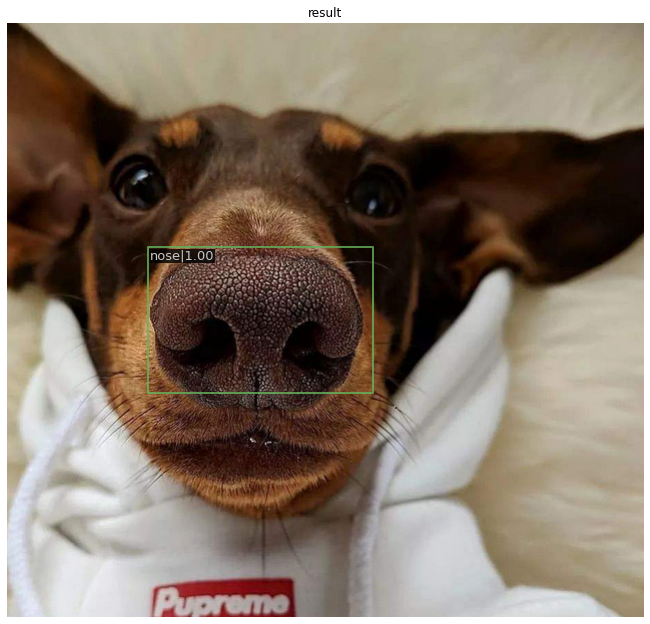

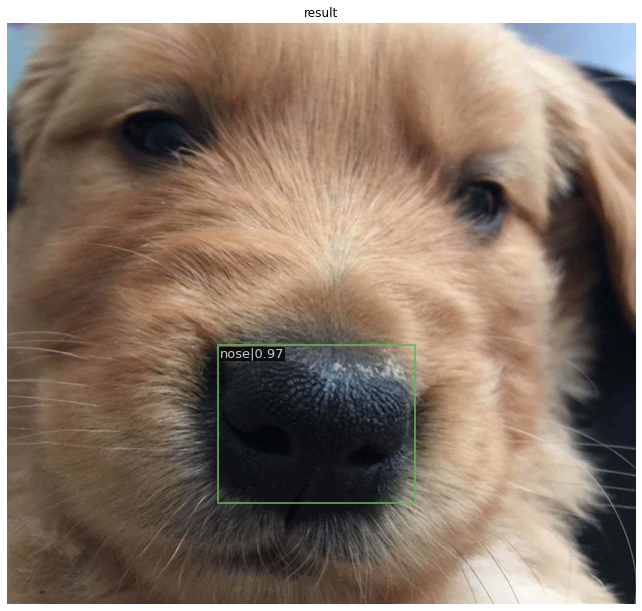

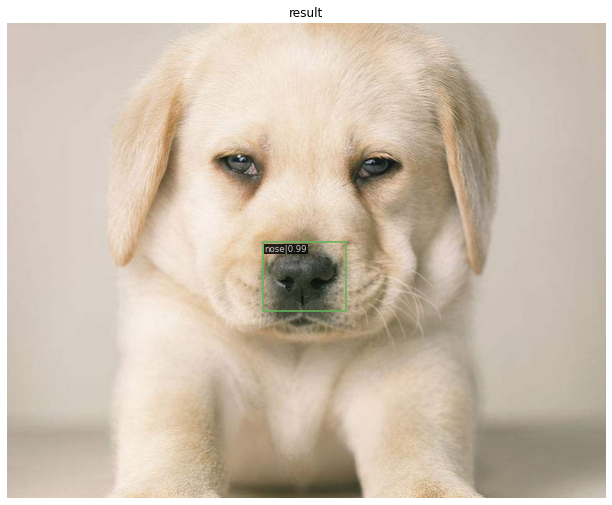

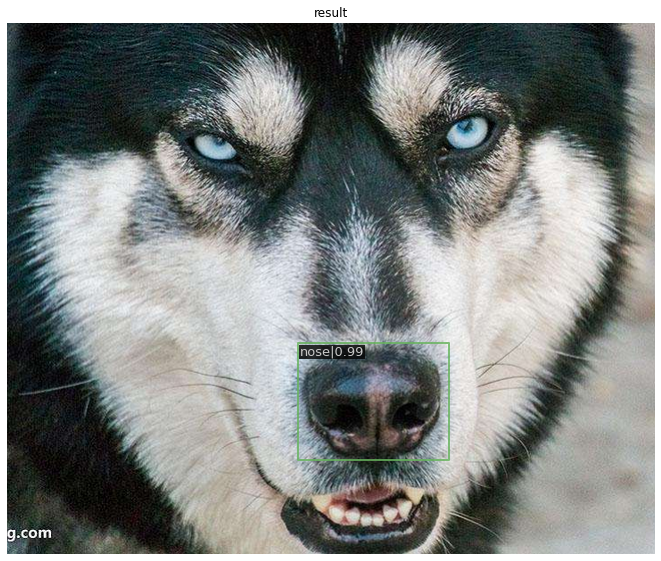

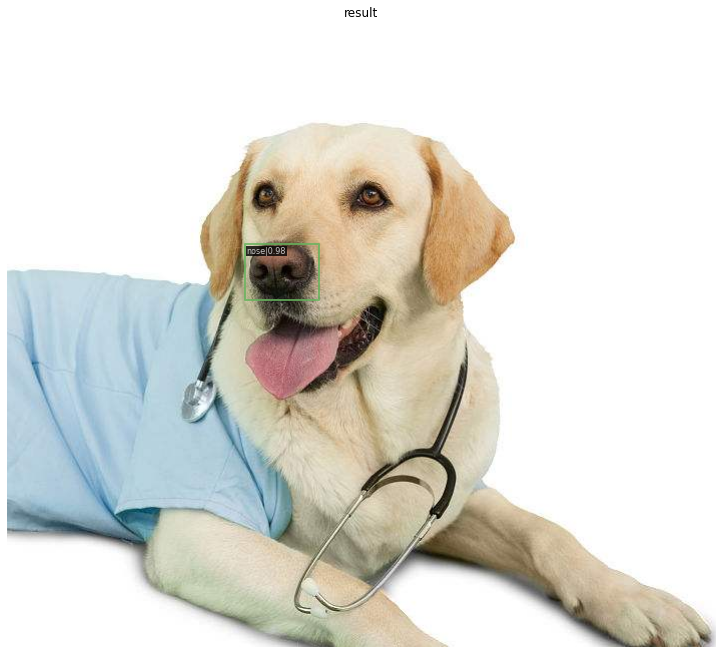

In [ ]:
import ipywidgets
import matplotlib.pyplot as plt
import cv2
from mmdet.apis import show_result_pyplot
from mmdet.apis import inference_detector
from mmdet.apis import init_detector

import mmcv
import glob as glob
import os

weights = '/content/drive/MyDrive/DogNose/outputs/baseline-rmclosedataset/epoch_50.pth'

# Build the model.

model = init_detector(cfg, weights, device='cuda:0')
# model = init_detector(cfg, args['weights'])

# fig = plt.figure(figsize=(20,40)) 
# rows = 1
# cols = 5

file_name = [14,20, 30, 48, 50]
for i, name in enumerate(file_name):
    img = "/content/drive/MyDrive/DogNose/mmdetection/nose/images/"+str(name)+".png"
    img = mmcv.imread(img)
    results = inference_detector(model, img)
    
    show_result_pyplot(model, img, results)

plt.show()

In [ ]:

# model = init_detector(cfg, args['weights'])
img ='/content/drive/MyDrive/DogNose/mmdetection/nose/images/20.png'
img = mmcv.imread(img)

# inference_detector의 인자로 string(file경로), ndarray가 단일 또는 list형태로 입력 될 수 있음. 
results = inference_detector(model, img)

from mmdet.apis import show_result_pyplot
# inference 된 결과를 원본 이미지에 적용하여 새로운 image로 생성(bbox 처리된 image)
# Default로 score threshold가 0.3 이상인 Object들만 시각화 적용. show_result_pyplot은 model.show_result()를 호출. 
show_result_pyplot(model, img, results)

AttributeError: ignored

load checkpoint from local path: /content/drive/MyDrive/DogNose/outputs/faster_rcnn_r50_fpn_1x_coco_20200130/epoch_50.pth


/content/drive/MyDrive/DogNose/mmdetection/mmdet/datasets/utils.py:66: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


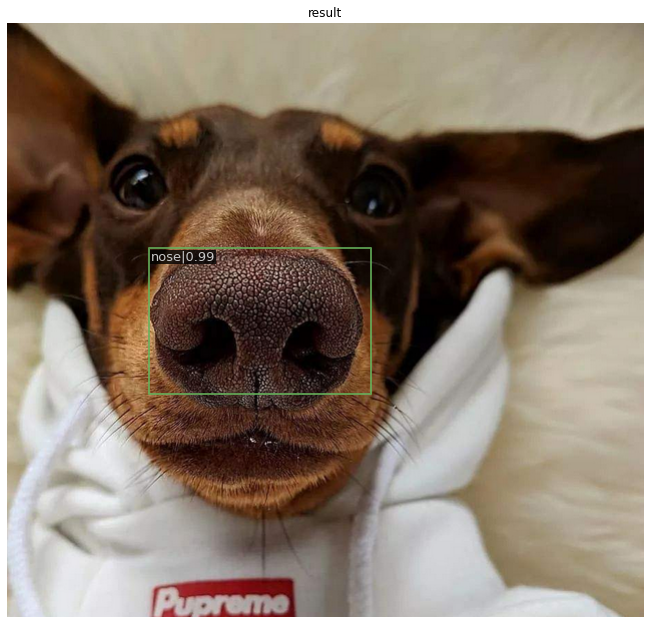

In [ ]:
from mmdet.apis import inference_detector
from mmdet.apis import init_detector

import mmcv
import glob as glob
import os
# Contruct the argument parser.
# parser = argparse.ArgumentParser()
weights = '/content/drive/MyDrive/DogNose/outputs/faster_rcnn_r50_fpn_1x_coco_20200130/epoch_50.pth'

# Build the model.

model = init_detector(cfg, weights, device='cuda:0')
# model = init_detector(cfg, args['weights'])
img ='/content/drive/MyDrive/DogNose/mmdetection/nose/images/14.png'
img = mmcv.imread(img)

# inference_detector의 인자로 string(file경로), ndarray가 단일 또는 list형태로 입력 될 수 있음. 
results = inference_detector(model, img)

from mmdet.apis import show_result_pyplot
# inference 된 결과를 원본 이미지에 적용하여 새로운 image로 생성(bbox 처리된 image)
# Default로 score threshold가 0.3 이상인 Object들만 시각화 적용. show_result_pyplot은 model.show_result()를 호출. 
show_result_pyplot(model, img, results)

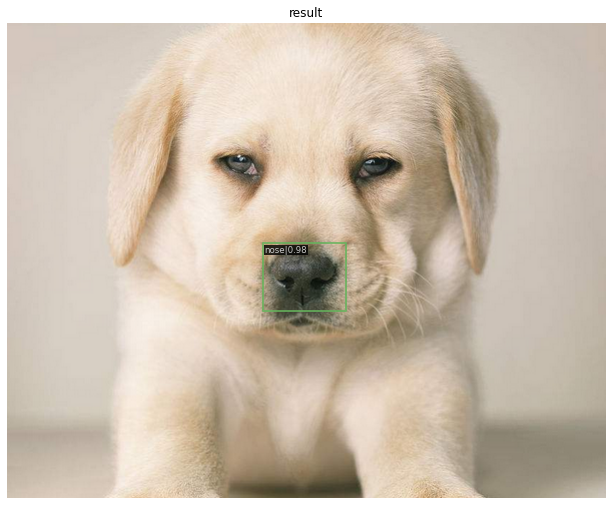

In [ ]:

# model = init_detector(cfg, args['weights'])
img ='/content/drive/MyDrive/DogNose/mmdetection/nose/images/30.png'
img = mmcv.imread(img)

# inference_detector의 인자로 string(file경로), ndarray가 단일 또는 list형태로 입력 될 수 있음. 
results = inference_detector(model, img)

from mmdet.apis import show_result_pyplot
# inference 된 결과를 원본 이미지에 적용하여 새로운 image로 생성(bbox 처리된 image)
# Default로 score threshold가 0.3 이상인 Object들만 시각화 적용. show_result_pyplot은 model.show_result()를 호출. 
show_result_pyplot(model, img, results)

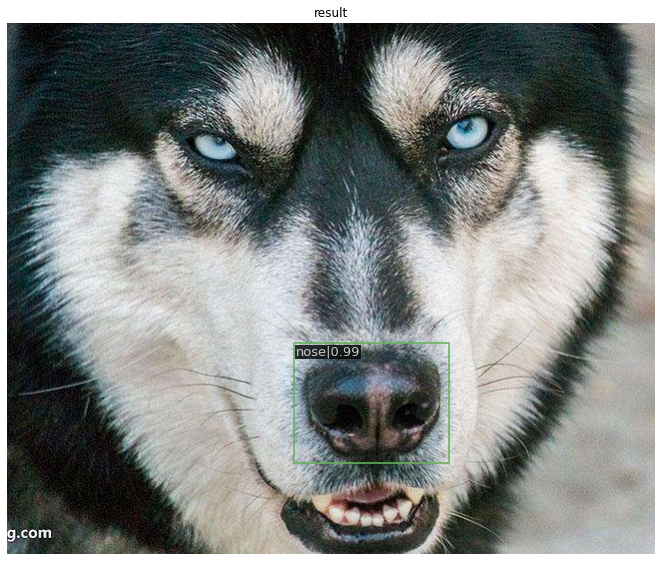

In [ ]:

# model = init_detector(cfg, args['weights'])
img ='/content/drive/MyDrive/DogNose/mmdetection/nose/images/48.png'
img = mmcv.imread(img)

# inference_detector의 인자로 string(file경로), ndarray가 단일 또는 list형태로 입력 될 수 있음. 
results = inference_detector(model, img)

from mmdet.apis import show_result_pyplot
# inference 된 결과를 원본 이미지에 적용하여 새로운 image로 생성(bbox 처리된 image)
# Default로 score threshold가 0.3 이상인 Object들만 시각화 적용. show_result_pyplot은 model.show_result()를 호출. 
show_result_pyplot(model, img, results)

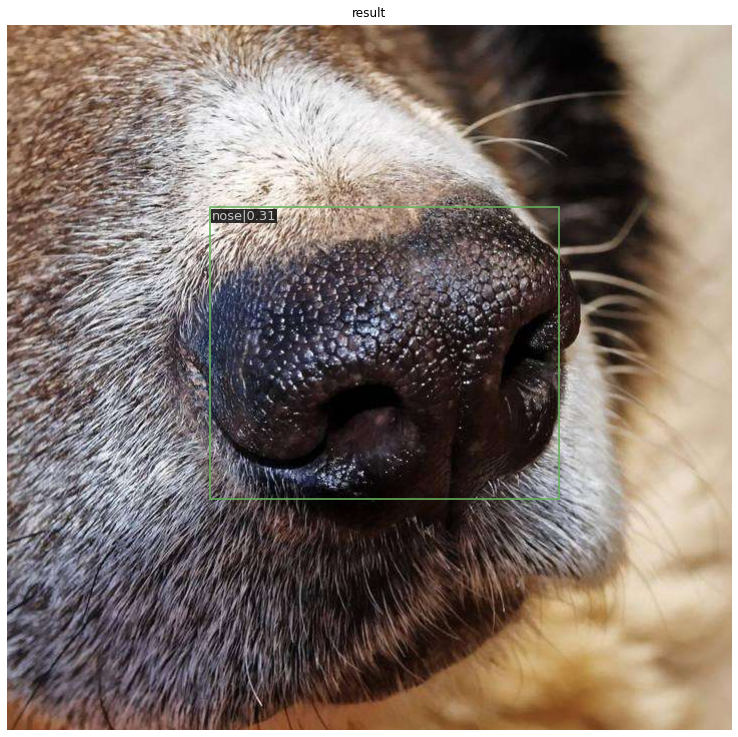

In [ ]:

# model = init_detector(cfg, args['weights'])
img ='/content/drive/MyDrive/DogNose/mmdetection/nose/images/.png'
img = mmcv.imread(img)

# inference_detector의 인자로 string(file경로), ndarray가 단일 또는 list형태로 입력 될 수 있음. 
results = inference_detector(model, img)

from mmdet.apis import show_result_pyplot
# inference 된 결과를 원본 이미지에 적용하여 새로운 image로 생성(bbox 처리된 image)
# Default로 score threshold가 0.3 이상인 Object들만 시각화 적용. show_result_pyplot은 model.show_result()를 호출. 
show_result_pyplot(model, img, results)

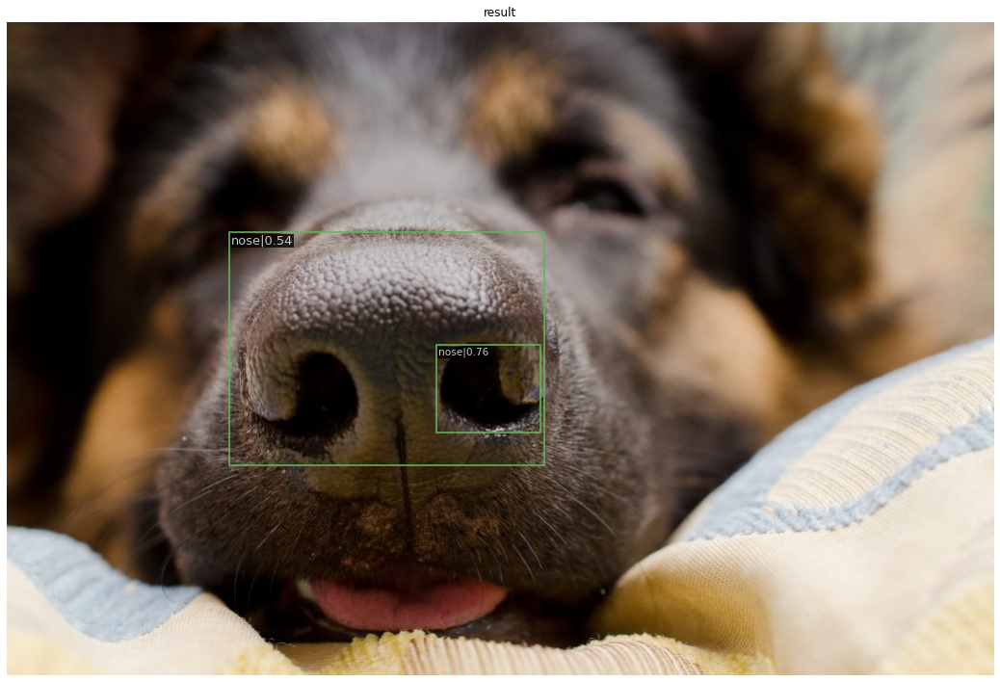

In [ ]:
img ='/content/drive/MyDrive/DogNose/testimage/AdobeStock_107280348-1024x678.jpeg'
img = mmcv.imread(img)

# inference_detector의 인자로 string(file경로), ndarray가 단일 또는 list형태로 입력 될 수 있음. 
results = inference_detector(model, img)

from mmdet.apis import show_result_pyplot
# inference 된 결과를 원본 이미지에 적용하여 새로운 image로 생성(bbox 처리된 image)
# Default로 score threshold가 0.3 이상인 Object들만 시각화 적용. show_result_pyplot은 model.show_result()를 호출. 
show_result_pyplot(model, img, results, 0.5)